# Black and White Image Colorisation
### Artificial Intelligence CS-370 End-Semester Project
#### Group Members:
Abdullah Bin Omer Zia | 291214 <br>
Tafheem-ul-Islam Malik | 321906
#### Section: CS-9-A

### Importing required libraries:

In [10]:
import glob
import time
import numpy as np
import math
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
import natsort


import torch
from torch import nn, optim
from torchvision import transforms as tt
from torch.utils.data import Dataset, DataLoader

from torchvision.datasets import ImageFolder
from torch.utils.data import random_split
from torchvision.utils import make_grid

%matplotlib inline

### Do not initialise dataset if you want to use the saved weights and test the model without training using the dataset

In [11]:
data_dir = "coco/"

In [12]:
paths = glob.glob(data_dir + "*.jpg") # Grabbing all the image file names
np.random.seed(7)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 10000 images randomly

In [13]:
SIZE = 256
class CocoUnlabeledDataset(Dataset):
    def __init__(self, paths, transforms):
        
        self.transforms = transforms
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = tt.ToTensor()(img_lab)
        L = img_lab[[0]] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2]] / 110. # Between -1 and 1
        
        return torch.cat((L, ab))
    
    def __len__(self):
        return len(self.paths)

In [14]:
validation_ratio = 0.2

image_transforms = tt.Compose([
    tt.Resize((SIZE, SIZE),  tt.InterpolationMode.BICUBIC)
])

data = CocoUnlabeledDataset(paths_subset, image_transforms)

validation_len = math.floor(len(data) * validation_ratio)
validation_data, train_data = random_split(data, [validation_len, len(data) - validation_len], 
                                           generator=torch.Generator().manual_seed(7))



The dataset is now split into <b>validation and training sets</b>. <br>
The first channel of any image in the dataset is the <b>L channel</b>. Second and third are <b>a and b channels</b> resprectively

Just plotting the L channnel gives us a black and white Image as shown:

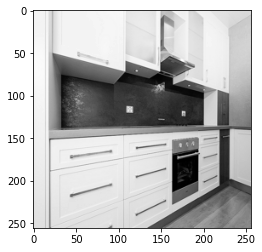

In [6]:
plt.imshow(validation_data[0][0], cmap='gray')

# Making dataloaders

In [15]:
train_dl = DataLoader(
    train_data,
    batch_size=8,
    pin_memory=True
)

valid_dl = DataLoader(
    validation_data,
    batch_size=8,
    pin_memory=True
)

In [16]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [17]:
device = get_default_device()
print(device)
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)

cuda


### Building the generator and pretraining before adversarial training

In [18]:
import fastai
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [19]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = get_default_device()
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

In [20]:
class AverageMeter:
    '''To calculate average for loss or accuracy or as required'''
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

In [63]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            data = data.permute(1, 0, 2, 3)
            L, ab = data[0].unsqueeze(0).permute(1, 0, 2, 3), data[[1,2]].permute(1, 0, 2, 3)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()  

In [66]:
from datetime import datetime


def displayLabImage(lab_img):
    '''
    Function for denormalising and displaying a normalised Lab image
    '''
    
    lab_img[0] = (lab_img[0] + 1) * 50 # Denormalising L channel
    lab_img[[1, 2]] = lab_img[[1, 2]] * 110 # Denormalising a and b channels
    
    fig = plt.figure()
    fig.add_subplot(1, 2, 1)
    plt.imshow(lab_img[[0]].permute(1,2,0), cmap='gray')
    print(lab_img[[0]].shape)
         
    img = lab_img.permute(1, 2, 0).numpy() # Bringing channels dimension to end (matplotlib requires it as such to show an image)
    img = lab2rgb(img)
#     pil_img = Image.fromarray((img * 255).astype("uint8"))
    
#     now = datetime.now()
#     current_time = now.strftime("%H_%M_%S")
#     pil_img.save(current_time + ".jpg")

    fig.add_subplot(1,2,2)
    plt.imshow(img)
    plt.savefig("baseline.jpg")

def colorise_image(img_path, model):
    '''
    Function for colorising an image and displaying the output.
    Takes image path as a parameter.
    If image is already colored it ignores the color and uses the model to generate its own.
    '''
    img = Image.open(img_path)
    img = tt.Resize((SIZE,SIZE))(img)

    img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
    img_lab = tt.ToTensor()(img_lab)
    
    L = img_lab[[0]].unsqueeze(dim=0) / 50. - 1 # unsqueezing to convert it to a "batch" of 1 image
    
    model.eval()
    with torch.no_grad():
        fake_color = model(L.to(device)).to('cpu')
    model.train()
        
    displayLabImage(torch.cat((L.squeeze(dim=0), fake_color[0])))

Displaying the output of the untrained generator:

torch.Size([1, 256, 256])


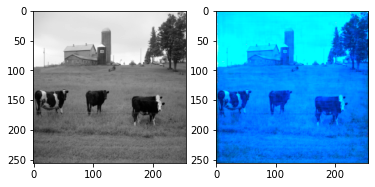

In [67]:
colorise_image(data_dir + "000000006974.jpg", net_G)

## DO NOT RUN BELOW CELL IF USING PRETRAINED WEIGHTS

In [19]:
pretrain_generator(net_G, train_dl, opt, criterion, 10)
torch.save(net_G.state_dict(), "res18-unet.pt")

  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 1/10
L1 Loss: 0.08620


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 2/10
L1 Loss: 0.08161


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 3/10
L1 Loss: 0.07952


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 4/10
L1 Loss: 0.07888


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 5/10
L1 Loss: 0.07720


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 6/10
L1 Loss: 0.07629


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 7/10
L1 Loss: 0.07492


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 8/10
L1 Loss: 0.07394


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 9/10
L1 Loss: 0.07288


  0%|          | 0/667 [00:00<?, ?it/s]

Epoch 10/10
L1 Loss: 0.07127


### Run below cell to load previously trained weights 

In [37]:
checkpoint = torch.load("res18-unet.pt")
net_G.load_state_dict(checkpoint)

<All keys matched successfully>

Displaying the output of the generator after 10 epochs of training:

torch.Size([1, 256, 256])


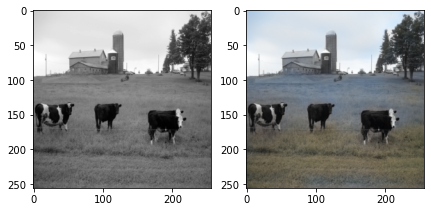

In [38]:
colorise_image(data_dir + "000000006974.jpg", net_G)

### Defining the Discriminator

In [39]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [40]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [41]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [42]:
class GANLoss(nn.Module):
    def __init__(self, real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        
        self.loss = nn.BCEWithLogitsLoss()
        
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [43]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [44]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = get_default_device()
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
            
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss().to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data.permute(1,0,2,3)[0]
        self.L = self.L.unsqueeze(0).permute(1,0,2,3)
        
        self.ab = data.permute(1,0,2,3)[[1,2]]
        self.ab = self.ab.permute(1,0,2,3)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [45]:
def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

In [46]:
def train_model(model, train_dl, epochs, display_every=400):
    # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        val_data = next(iter(valid_dl))
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data[[0]].permute(1,0,2,3).size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, val_data, save=False) # function displaying the model's outputs

In [47]:
model = MainModel(net_G=net_G)

model initialized with norm initialization


In [48]:
model.load_state_dict(torch.load('main_model_16_epochs.pth'))

<All keys matched successfully>

### Training the model
### DO NOT RUN TRAINING CELLS IF USING SAVED WEIGHTS

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 1/16
Iteration 400/1000
loss_D_fake: 0.57614
loss_D_real: 0.62019
loss_D: 0.59816
loss_G_GAN: 1.10133
loss_G_L1: 8.05225
loss_G: 9.15359


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return func(*args, **kwargs)


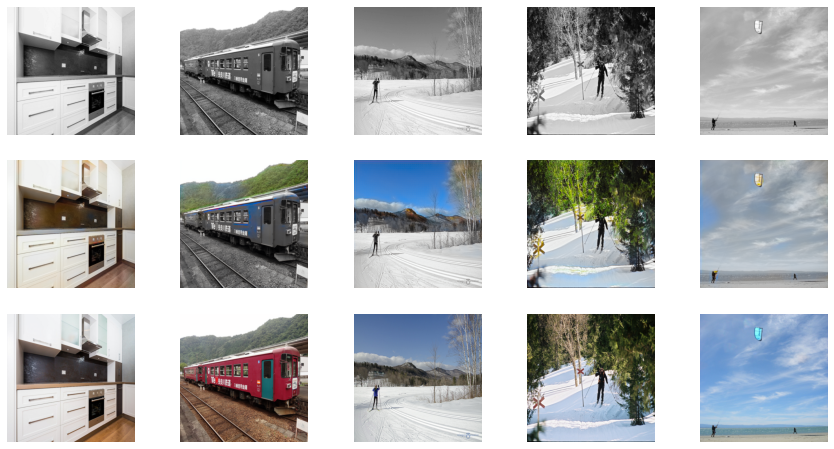


Epoch 1/16
Iteration 800/1000
loss_D_fake: 0.57800
loss_D_real: 0.61901
loss_D: 0.59851
loss_G_GAN: 1.08989
loss_G_L1: 8.03275
loss_G: 9.12264


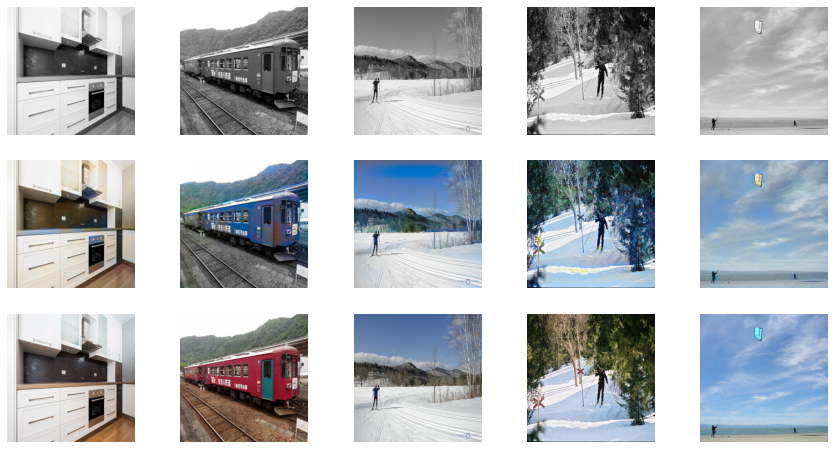

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 2/16
Iteration 400/1000
loss_D_fake: 0.56664
loss_D_real: 0.61205
loss_D: 0.58935
loss_G_GAN: 1.08464
loss_G_L1: 7.86105
loss_G: 8.94570


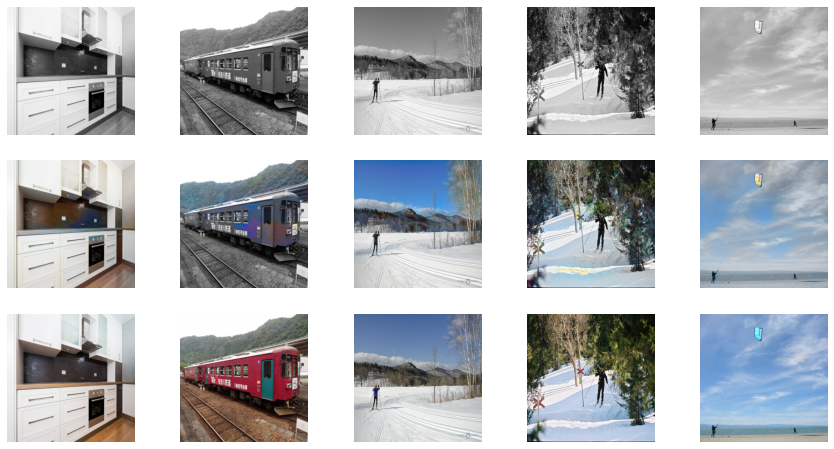


Epoch 2/16
Iteration 800/1000
loss_D_fake: 0.57538
loss_D_real: 0.61405
loss_D: 0.59471
loss_G_GAN: 1.07420
loss_G_L1: 7.80986
loss_G: 8.88406


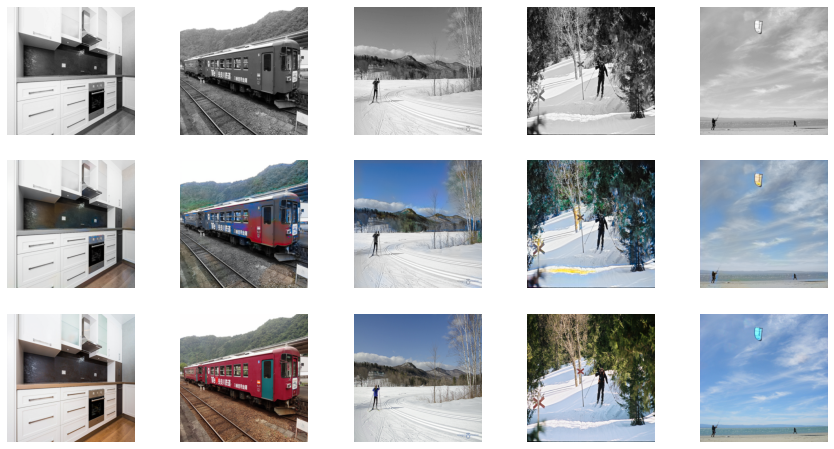

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 3/16
Iteration 400/1000
loss_D_fake: 0.56922
loss_D_real: 0.61788
loss_D: 0.59355
loss_G_GAN: 1.07331
loss_G_L1: 7.61902
loss_G: 8.69232


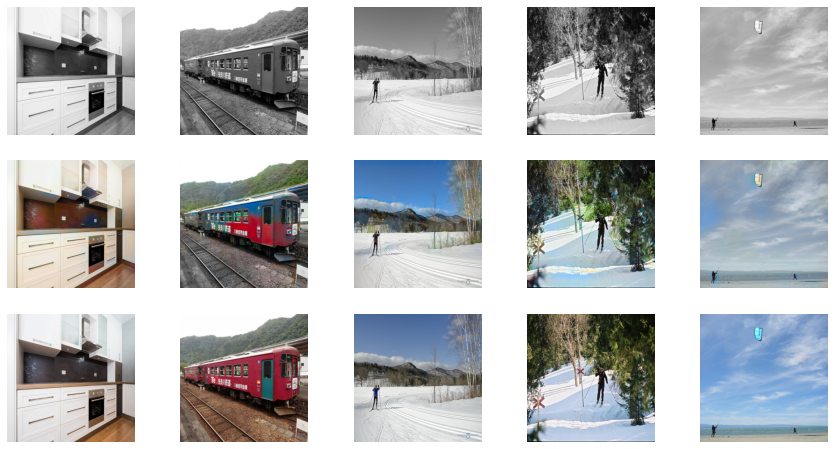


Epoch 3/16
Iteration 800/1000
loss_D_fake: 0.57500
loss_D_real: 0.61756
loss_D: 0.59628
loss_G_GAN: 1.06428
loss_G_L1: 7.57652
loss_G: 8.64080


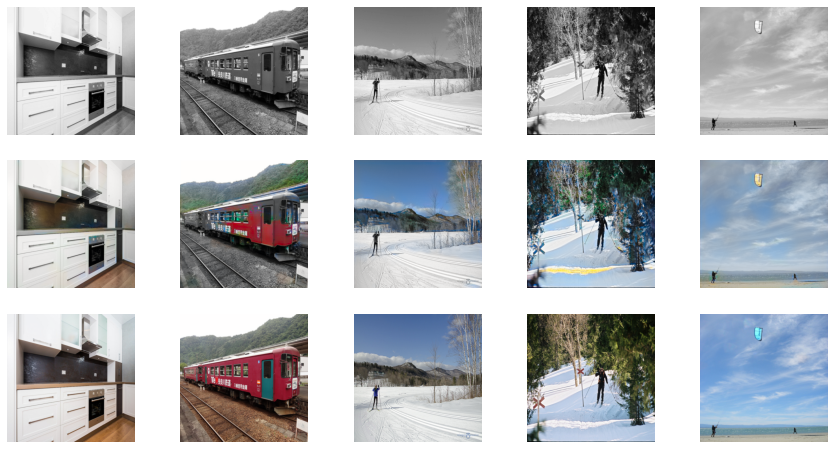

  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [26]:
train_model(model, train_dl, 3)

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 1/3
Iteration 400/1000
loss_D_fake: 0.57597
loss_D_real: 0.61525
loss_D: 0.59561
loss_G_GAN: 1.06927
loss_G_L1: 7.42578
loss_G: 8.49505


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


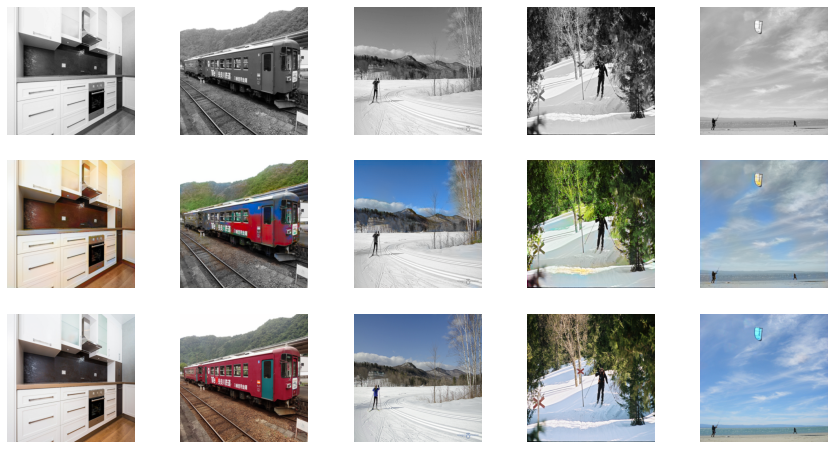


Epoch 1/3
Iteration 800/1000
loss_D_fake: 0.58144
loss_D_real: 0.61749
loss_D: 0.59946
loss_G_GAN: 1.05543
loss_G_L1: 7.39894
loss_G: 8.45438


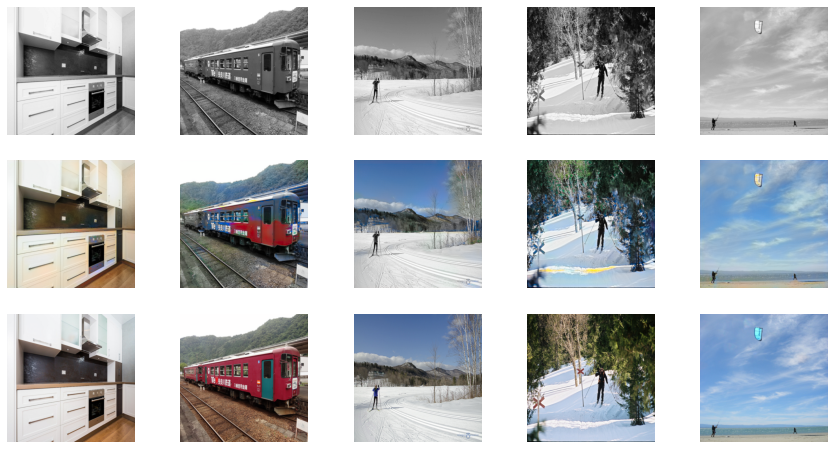

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 2/3
Iteration 400/1000
loss_D_fake: 0.57457
loss_D_real: 0.61690
loss_D: 0.59573
loss_G_GAN: 1.06990
loss_G_L1: 7.21896
loss_G: 8.28885


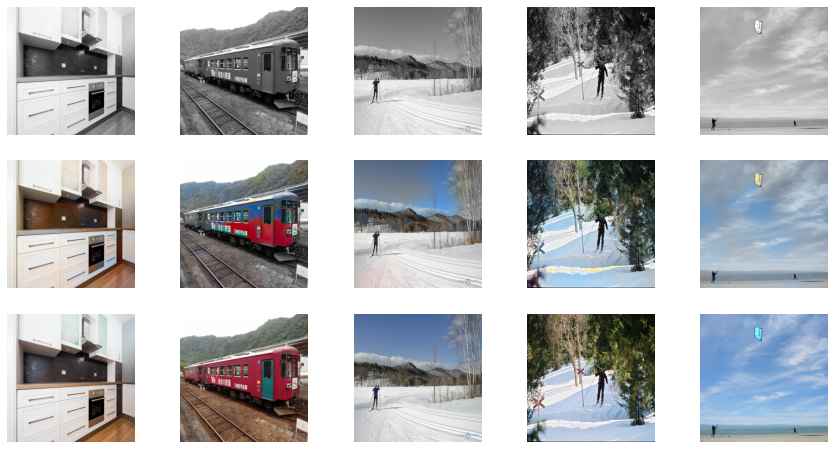


Epoch 2/3
Iteration 800/1000
loss_D_fake: 0.58113
loss_D_real: 0.61677
loss_D: 0.59895
loss_G_GAN: 1.05031
loss_G_L1: 7.19285
loss_G: 8.24316


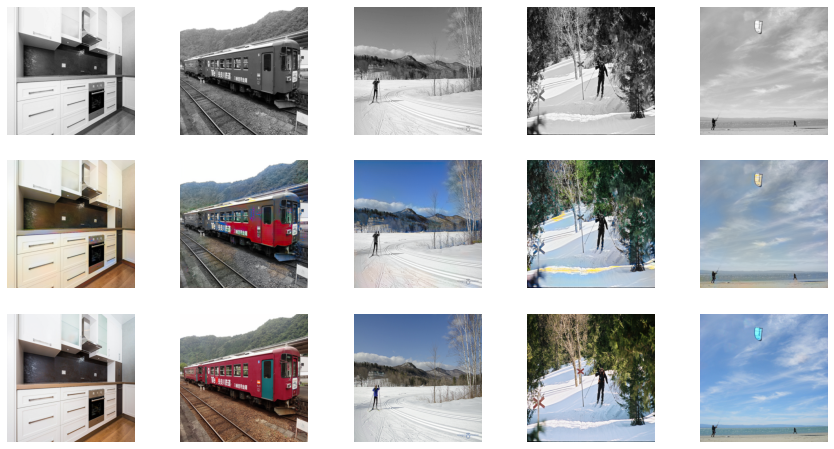

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 3/3
Iteration 400/1000
loss_D_fake: 0.57757
loss_D_real: 0.61834
loss_D: 0.59796
loss_G_GAN: 1.05488
loss_G_L1: 7.02382
loss_G: 8.07870


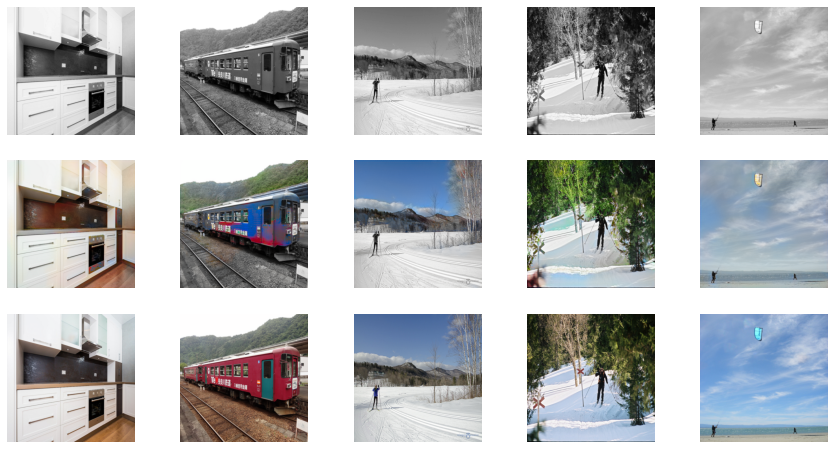


Epoch 3/3
Iteration 800/1000
loss_D_fake: 0.58561
loss_D_real: 0.61824
loss_D: 0.60192
loss_G_GAN: 1.04151
loss_G_L1: 6.97695
loss_G: 8.01846


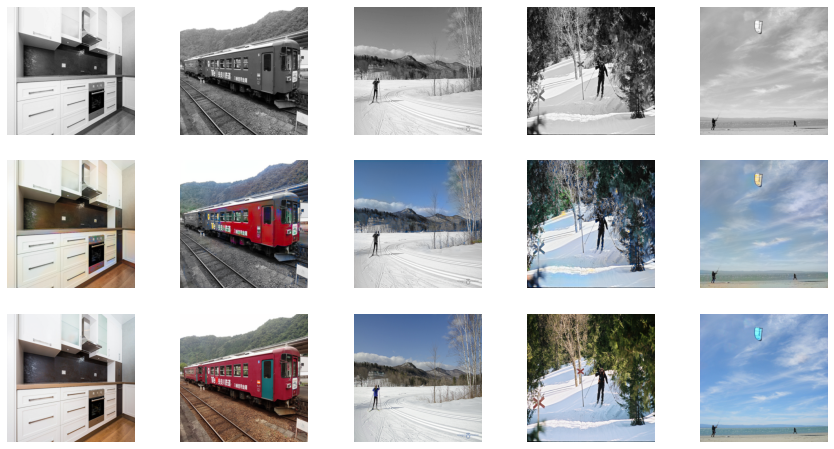

In [24]:
train_model(model, train_dl, 3)

In [61]:
#torch.save(model.state_dict(), 'main_model_16_epochs.pth')

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 1/3
Iteration 400/1000
loss_D_fake: 0.58447
loss_D_real: 0.62093
loss_D: 0.60270
loss_G_GAN: 1.03149
loss_G_L1: 6.80084
loss_G: 7.83234


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


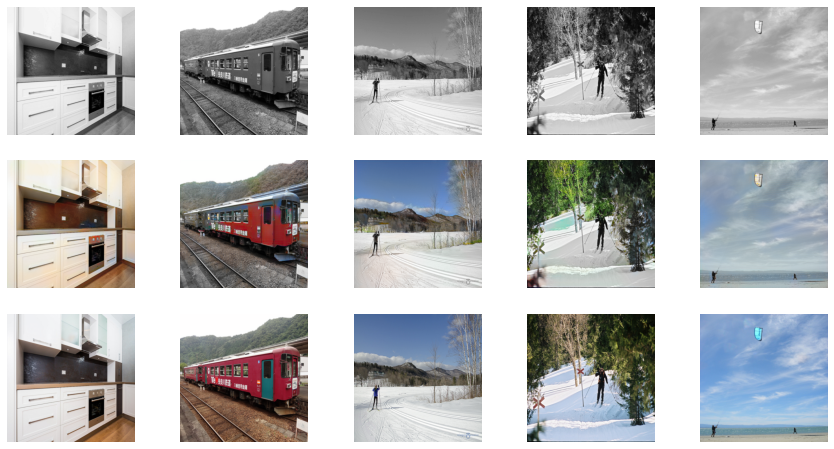


Epoch 1/3
Iteration 800/1000
loss_D_fake: 0.58941
loss_D_real: 0.62133
loss_D: 0.60537
loss_G_GAN: 1.02349
loss_G_L1: 6.76301
loss_G: 7.78650


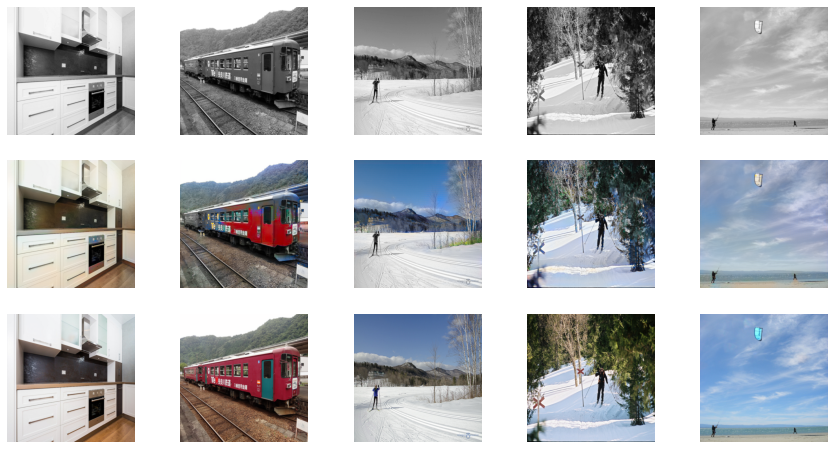

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 2/3
Iteration 400/1000
loss_D_fake: 0.58708
loss_D_real: 0.61955
loss_D: 0.60331
loss_G_GAN: 1.02915
loss_G_L1: 6.62708
loss_G: 7.65624


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)
C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)


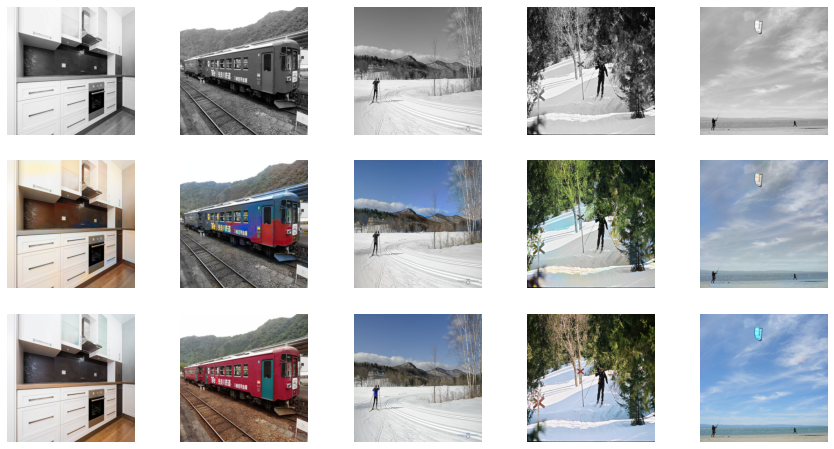


Epoch 2/3
Iteration 800/1000
loss_D_fake: 0.59015
loss_D_real: 0.61956
loss_D: 0.60486
loss_G_GAN: 1.01760
loss_G_L1: 6.58723
loss_G: 7.60484


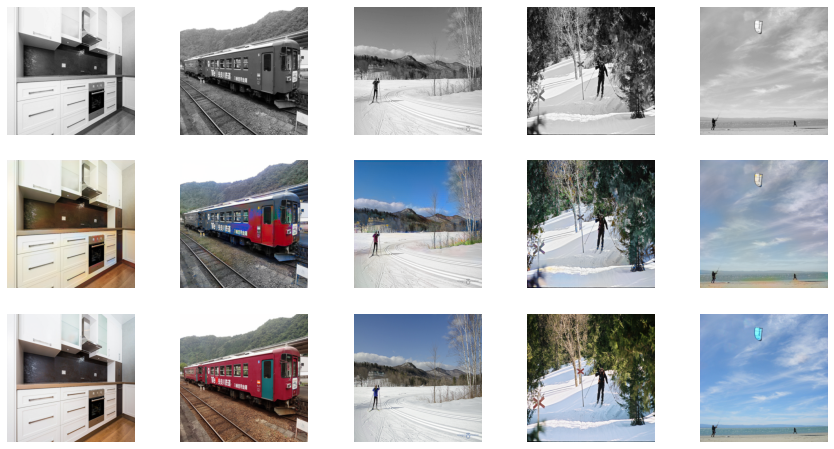

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 3/3
Iteration 400/1000
loss_D_fake: 0.58454
loss_D_real: 0.62407
loss_D: 0.60430
loss_G_GAN: 1.01504
loss_G_L1: 6.42937
loss_G: 7.44441


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)


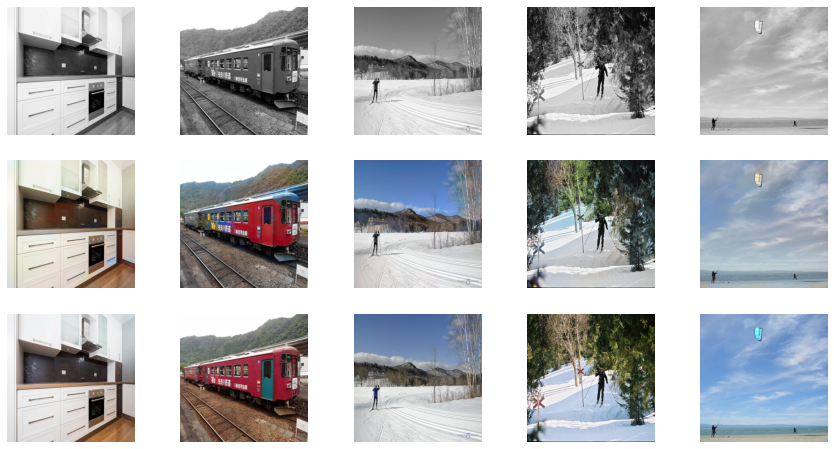


Epoch 3/3
Iteration 800/1000
loss_D_fake: 0.59044
loss_D_real: 0.62365
loss_D: 0.60704
loss_G_GAN: 1.00676
loss_G_L1: 6.36421
loss_G: 7.37097


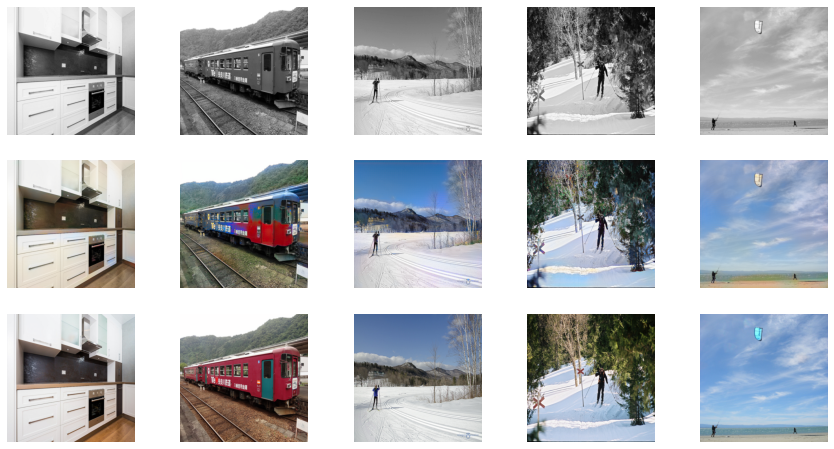

In [25]:
train_model(model, train_dl, 3)

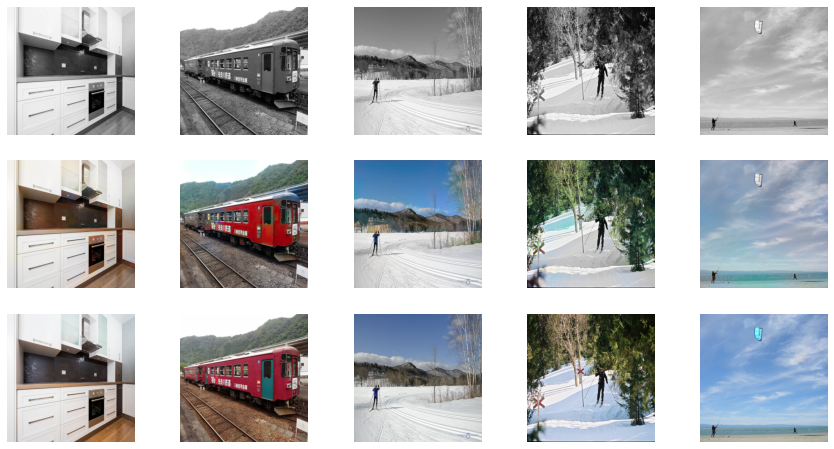

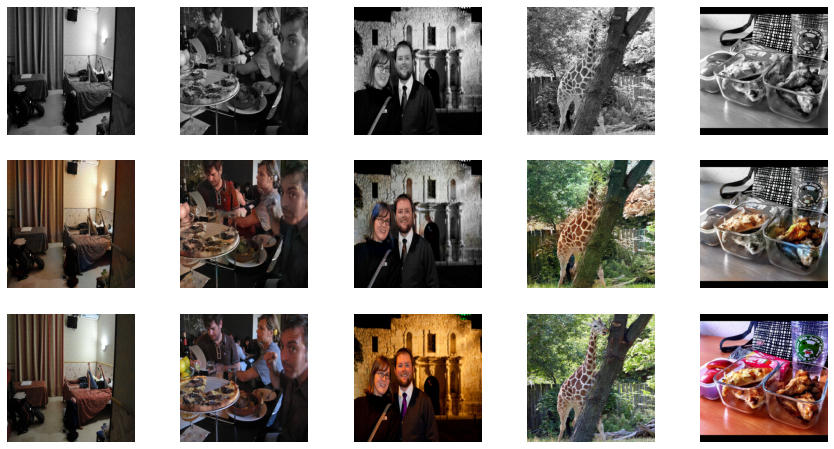

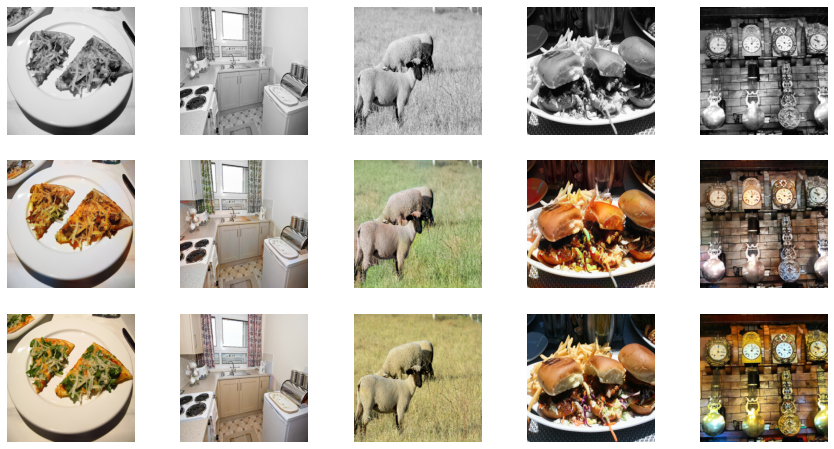

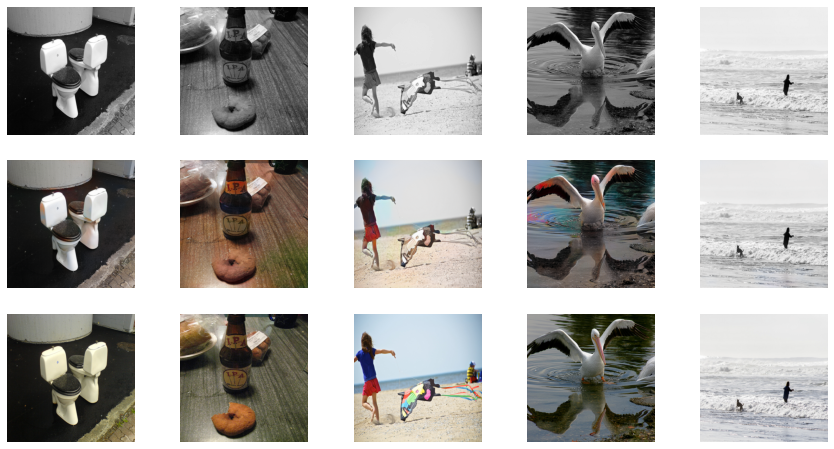

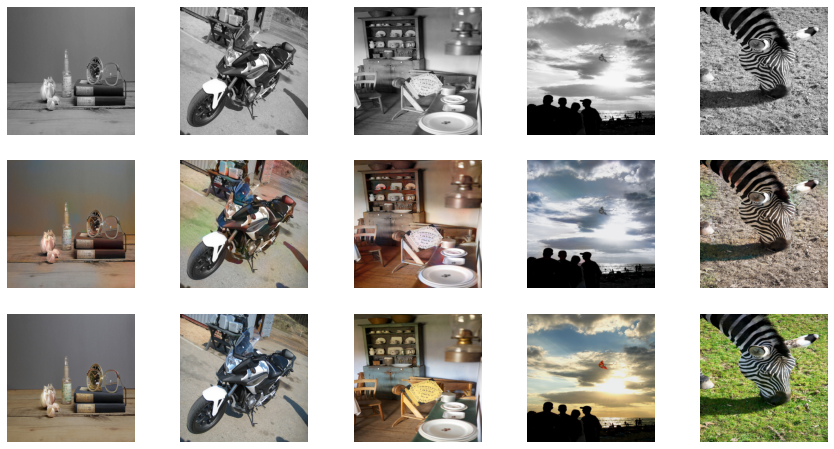

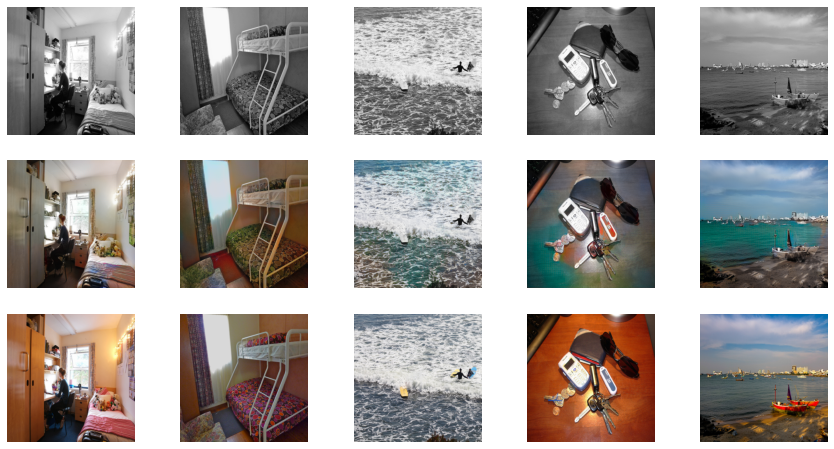

In [26]:
p = 0
for batch in valid_dl:
    p+= 1
    visualize(model, batch, save=False)
    if p > 5:
        break

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 1/3
Iteration 400/1000
loss_D_fake: 0.59313
loss_D_real: 0.62573
loss_D: 0.60943
loss_G_GAN: 1.00399
loss_G_L1: 6.19465
loss_G: 7.19864


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return func(*args, **kwargs)


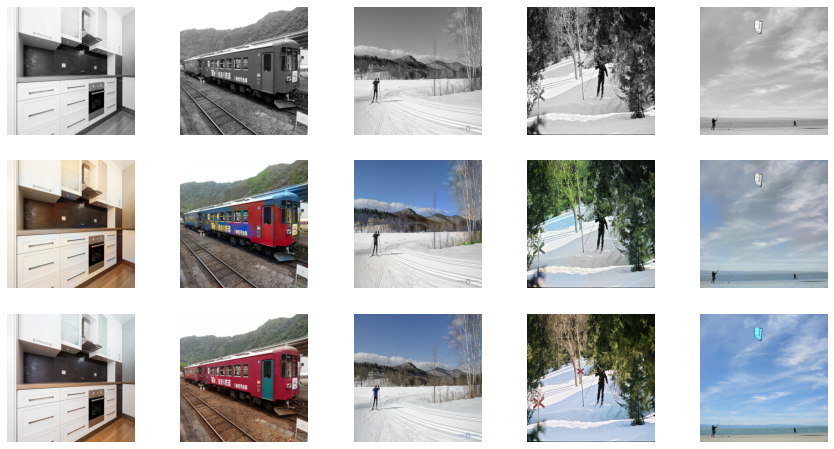


Epoch 1/3
Iteration 800/1000
loss_D_fake: 0.59788
loss_D_real: 0.62570
loss_D: 0.61179
loss_G_GAN: 0.99531
loss_G_L1: 6.16597
loss_G: 7.16128


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


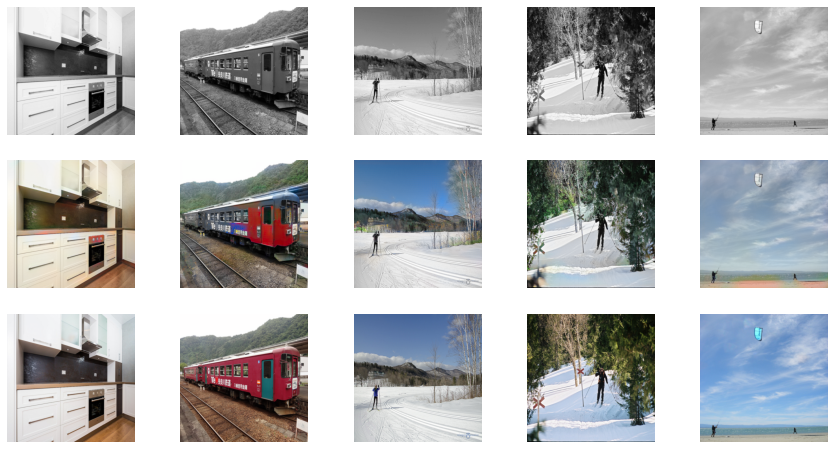

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 2/3
Iteration 400/1000
loss_D_fake: 0.59797
loss_D_real: 0.62697
loss_D: 0.61247
loss_G_GAN: 0.99440
loss_G_L1: 5.97350
loss_G: 6.96790


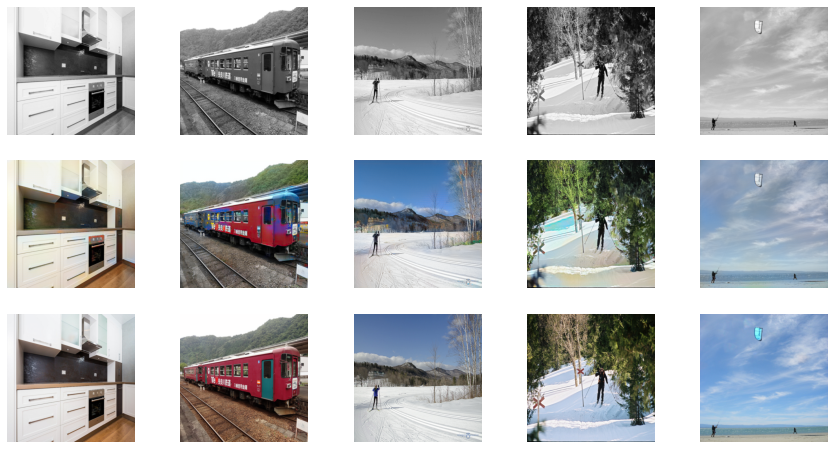


Epoch 2/3
Iteration 800/1000
loss_D_fake: 0.60114
loss_D_real: 0.62718
loss_D: 0.61416
loss_G_GAN: 0.98508
loss_G_L1: 5.94264
loss_G: 6.92772


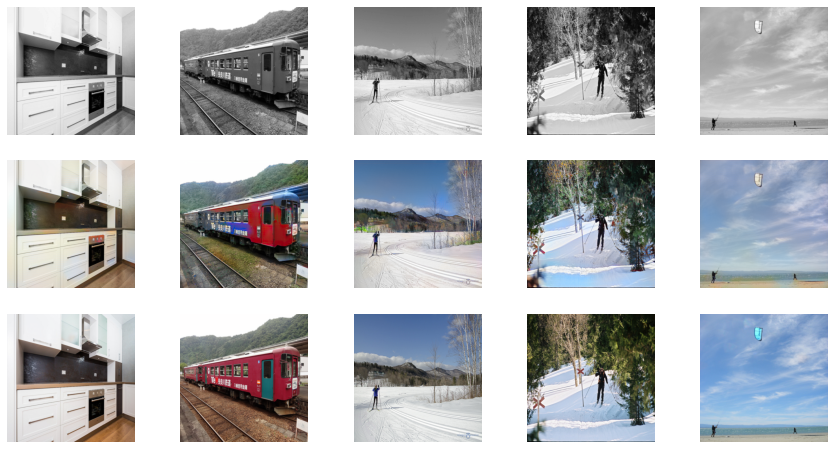

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 3/3
Iteration 400/1000
loss_D_fake: 0.59855
loss_D_real: 0.62798
loss_D: 0.61326
loss_G_GAN: 0.98061
loss_G_L1: 5.83517
loss_G: 6.81578


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return func(*args, **kwargs)


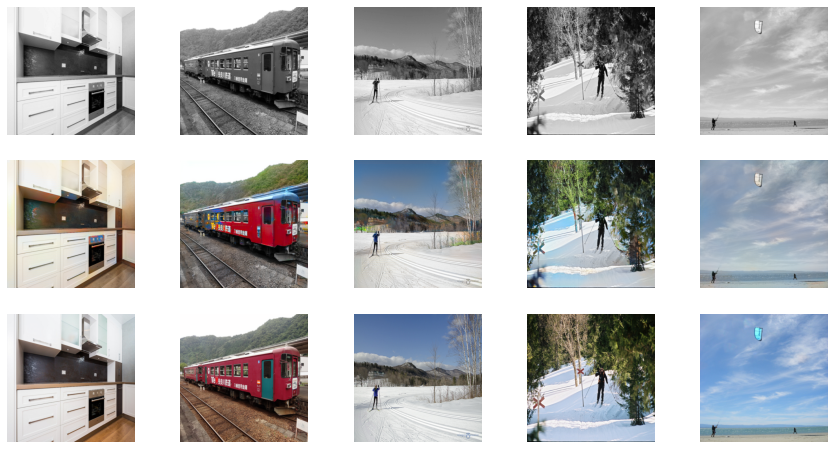


Epoch 3/3
Iteration 800/1000
loss_D_fake: 0.60339
loss_D_real: 0.62838
loss_D: 0.61588
loss_G_GAN: 0.97555
loss_G_L1: 5.77215
loss_G: 6.74770


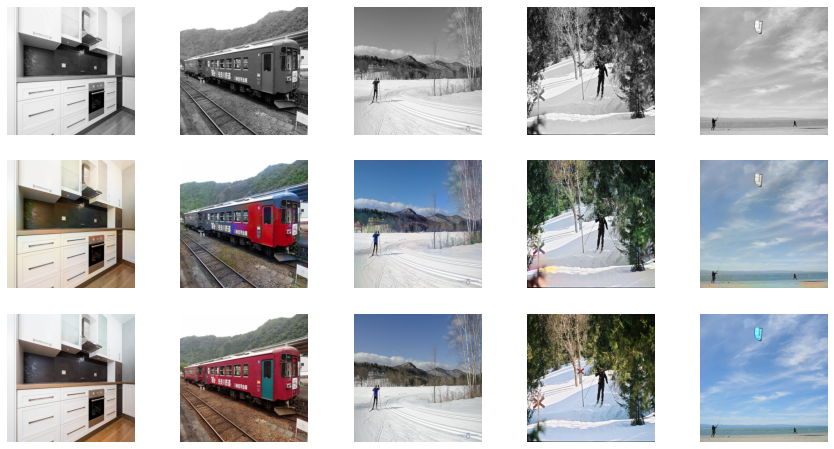

In [24]:
train_model(model, train_dl, 3)

  0%|          | 0/1000 [00:00<?, ?it/s]


Epoch 1/1
Iteration 400/1000
loss_D_fake: 0.60530
loss_D_real: 0.62971
loss_D: 0.61750
loss_G_GAN: 0.97512
loss_G_L1: 5.66314
loss_G: 6.63825


C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)


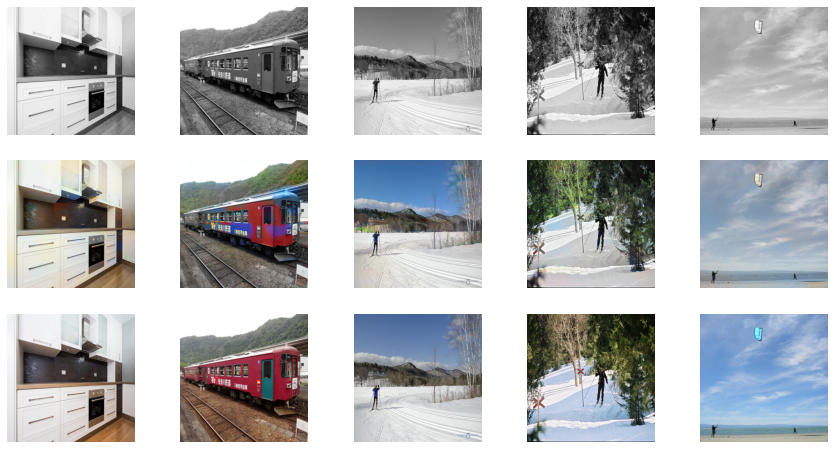


Epoch 1/1
Iteration 800/1000
loss_D_fake: 0.60680
loss_D_real: 0.63023
loss_D: 0.61851
loss_G_GAN: 0.96615
loss_G_L1: 5.60908
loss_G: 6.57523


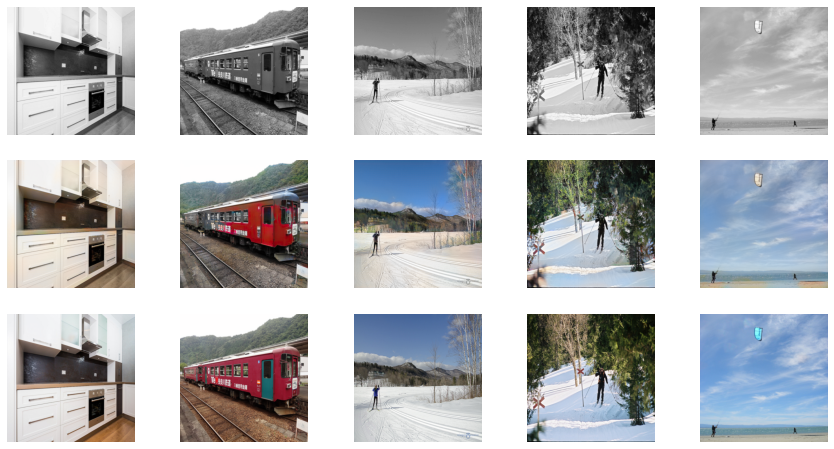

In [26]:
train_model(model, train_dl, 1)

C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)


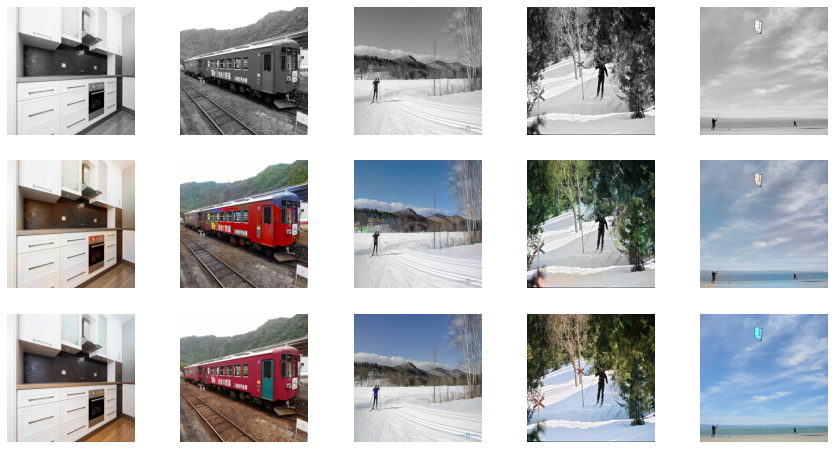

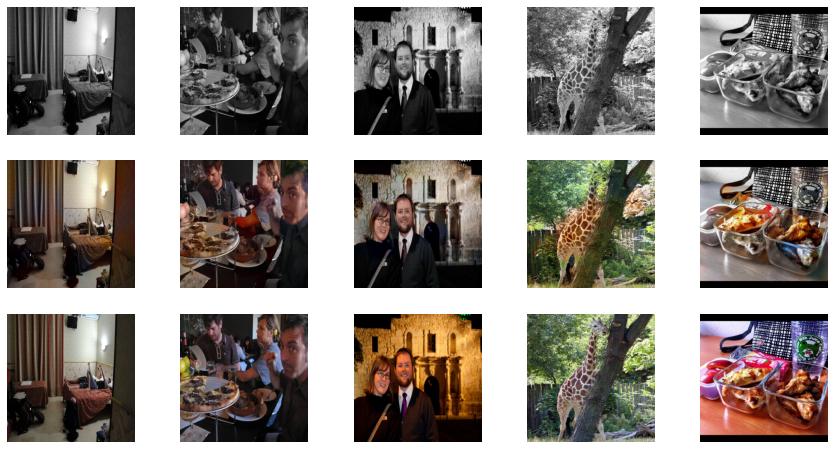

C:\ProgramData\Anaconda3\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


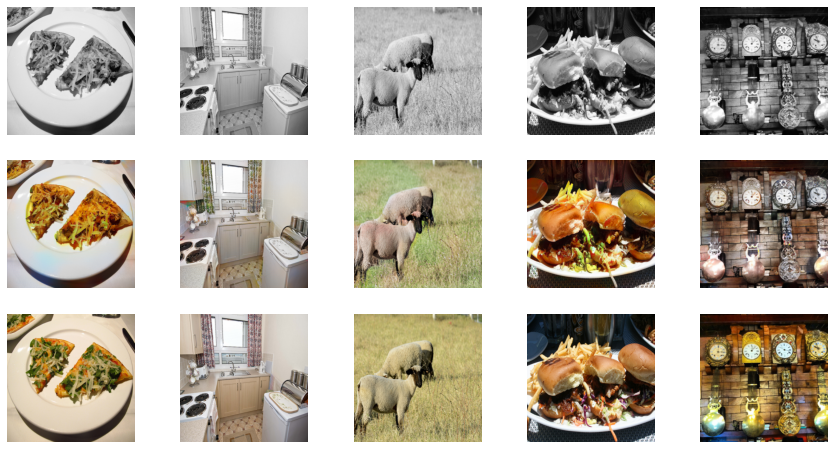

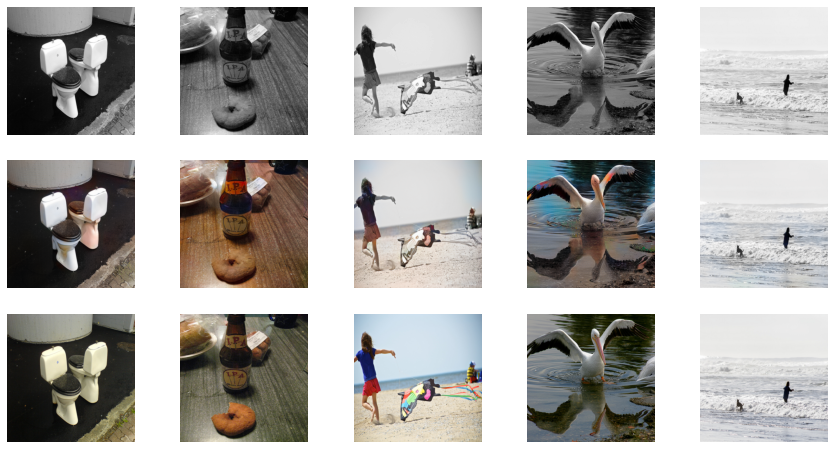

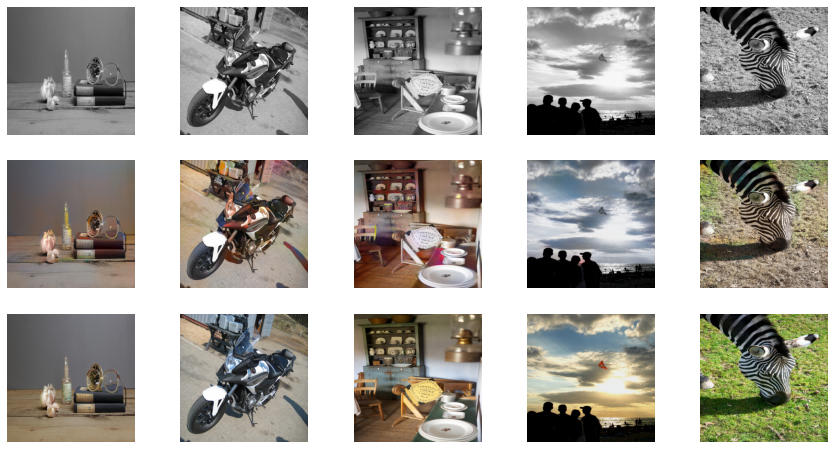

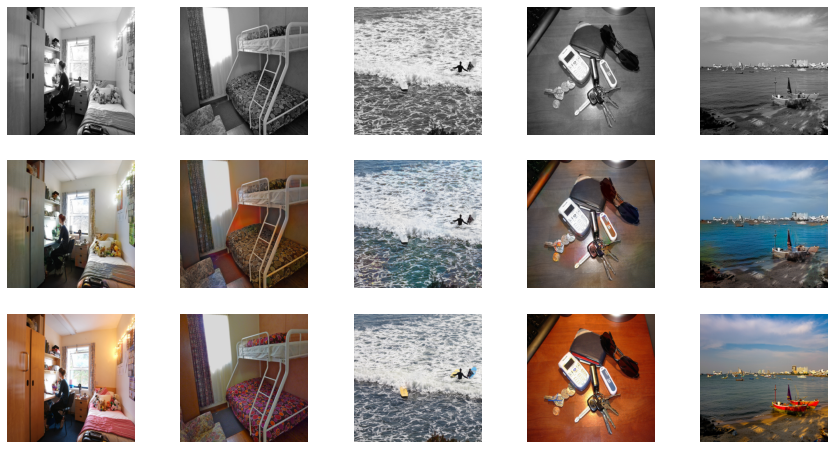

In [132]:
p = 0
for batch in valid_dl:
    p+= 1
    visualize(model, batch, save=False)
    if p > 5:
        break

In [173]:
model.load_state_dict(torch.load('main_model_16_epochs.pth'))

<All keys matched successfully>

## Example outputs of our model: 
### Replace your desired image location as the argument for the function colorise_image() to see outputs on your own data

torch.Size([1, 256, 256])


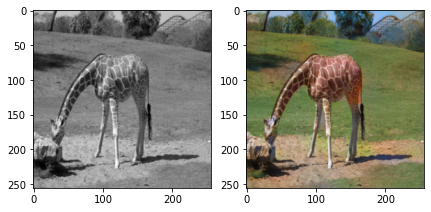

In [49]:
colorise_image(data_dir + "000000000498.jpg", model.net_G)

torch.Size([1, 256, 256])


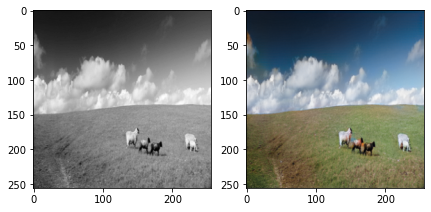

In [50]:
colorise_image(data_dir + "000000003864.jpg", model.net_G)

torch.Size([1, 256, 256])


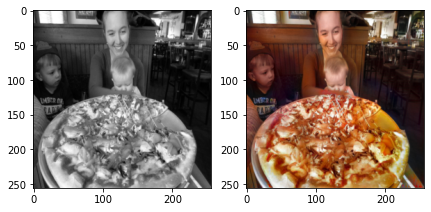

In [174]:
colorise_image(data_dir + "000000005455.jpg", model.net_G)

torch.Size([1, 256, 256])


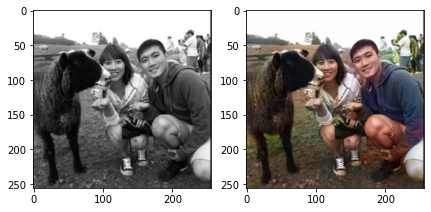

In [51]:
colorise_image(data_dir+"000000005734.jpg", model.net_G)

torch.Size([1, 256, 256])


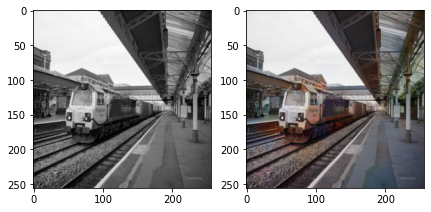

In [178]:
colorise_image(data_dir+"000000006501.jpg", model.net_G)

torch.Size([1, 256, 256])


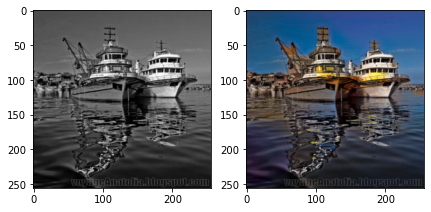

In [179]:
colorise_image(data_dir+"000000010905.jpg", model.net_G)

torch.Size([1, 256, 256])


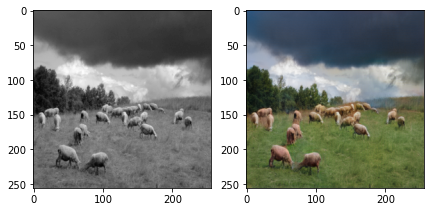

In [52]:
colorise_image(data_dir+"000000011372.jpg", model.net_G)

torch.Size([1, 256, 256])


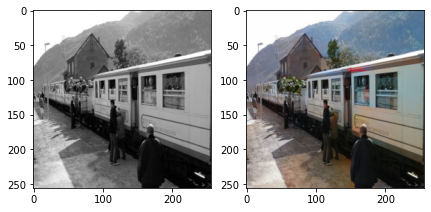

In [53]:
colorise_image(data_dir+"000000001495.jpg", model.net_G)

torch.Size([1, 256, 256])


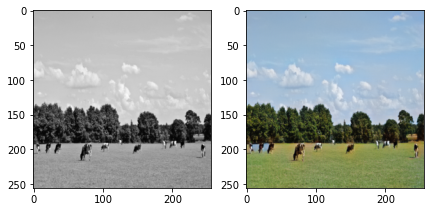

In [54]:
colorise_image(data_dir+"000000001603.jpg", model.net_G)

torch.Size([1, 256, 256])


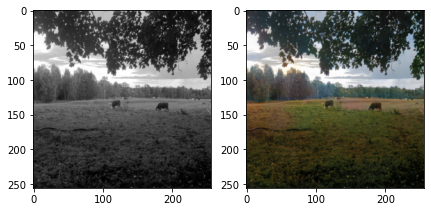

In [62]:
colorise_image(data_dir+"000000004611.jpg", model.net_G)